This implementation uses fully convolutional neural network for Newspaper Segmentation in JPEG domain.

# *  The dataset was downloaded from UCI repository - 
https://archive.ics.uci.edu/ml/datasets/Newspaper+and+magazine+images+segmentation+dataset

* This dataset was collected for training and validation of machine learning algorithm for classification regions of documents on text, picture and background areas. It contains 101 scanned images of various newspapers and magazines in Russian. Most of the images have resolution 300 dpi and size A4, about 2400x3500 pixels. For all images ground truth pixel-based masks were manually created. The ground truth masks named like original images with postfix _m. There are three classes: text area, picture area, background.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import glob
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import cv2
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split
from google.colab import files

In [ ]:
from keras.models import Model
from keras.layers import *
from keras.optimizers import Adam
from keras.regularizers import l2
from keras.preprocessing.image import ImageDataGenerator
import keras.backend as K
from keras.callbacks import LearningRateScheduler, ModelCheckpoint, EarlyStopping
from keras.models import model_from_json

In [ ]:
IMAGE_LIB = '/content/drive/MyDrive/MiniProject/RussianNewspaperDataset/'
IMG_HEIGHT, IMG_WIDTH = 1024, 512
SEED=42

In [ ]:
all_masks = [x for x in sorted(os.listdir(IMAGE_LIB)) if x[-6:-4] == '_m']
all_images = []
for i,name in enumerate(all_masks):
    for x in sorted(os.listdir(IMAGE_LIB)):
        if x.startswith(name[:-6]) and x[-6:-4] != '_m':
            all_images.append(x)
            break

In [ ]:
x_data = np.empty((len(all_images), IMG_HEIGHT, IMG_WIDTH, 3), dtype='float32')
for i, name in enumerate(all_images):
    img = cv2.imread(IMAGE_LIB + name).astype('float32')/255
    im = cv2.resize(img, (IMG_WIDTH, IMG_HEIGHT))
    #im = (im - np.min(im)) / (np.max(im) - np.min(im))
    x_data[i] = im

y_data = np.empty((len(all_masks), IMG_HEIGHT, IMG_WIDTH, 3), dtype='float32')
for i, name in enumerate(all_masks):
    im = cv2.imread(IMAGE_LIB + name).astype('float32')/255
    im = cv2.resize(im, dsize=(IMG_WIDTH, IMG_HEIGHT))
    #im = (im - np.min(im)) / (np.max(im) - np.min(im))
    y_data[i] = im

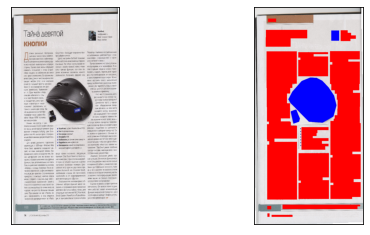

In [ ]:
fig, ax = plt.subplots(1,2, figsize = (8,4))
ax[0].set_xticks([])
ax[1].set_xticks([])
ax[0].set_yticks([])
ax[1].set_yticks([])
ax[0].imshow(x_data[0])
ax[1].imshow(y_data[0])
plt.show()

In [ ]:
x_data.shape

(101, 1024, 512, 3)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x_data, y_data, test_size = 0.3)

In [ ]:
input_layer = Input(shape=x_train.shape[1:])
c1 = Conv2D(filters=8, kernel_size=(7,7), activation='relu', padding='same')(input_layer)
l = MaxPool2D(strides=(2,2))(c1)
c2 = Conv2D(filters=16, kernel_size=(5,5), activation='relu', padding='same')(l)
l = MaxPool2D(strides=(2,2))(c2)
c3 = Conv2D(filters=32, kernel_size=(3,3), activation='relu', padding='same')(l)
l = MaxPool2D(strides=(2,2))(c3)
c4 = Conv2D(filters=32, kernel_size=(1,1), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(c4), c3], axis=-1)
l = Conv2D(filters=32, kernel_size=(2,2), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(l), c2], axis=-1)
l = Conv2D(filters=24, kernel_size=(2,2), activation='relu', padding='same')(l)
l = concatenate([UpSampling2D(size=(2,2))(l), c1], axis=-1)
l = Conv2D(filters=16, kernel_size=(2,2), activation='relu', padding='same')(l)
l = Conv2D(filters=64, kernel_size=(1,1), activation='relu')(l)
l = Dropout(0.5)(l)
output_layer = Conv2D(filters=3, kernel_size=(1,1), activation='sigmoid')(l)
                                                         
model = Model(input_layer, output_layer)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 1024, 512, 3 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 1024, 512, 8) 1184        input_1[0][0]                    
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 512, 256, 8)  0           conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 256, 16) 3216        max_pooling2d[0][0]              
______________________________________________________________________________________________

In [ ]:
def my_generator(x_train, y_train, batch_size):
    data_generator = ImageDataGenerator().flow(x_train, y=None, batch_size=batch_size, seed=SEED)
    mask_generator = ImageDataGenerator().flow(y_train, y=None, batch_size=batch_size, seed=SEED)
    while True:
        x_batch = data_generator.next()
        y_batch = mask_generator.next()
        yield x_batch, y_batch

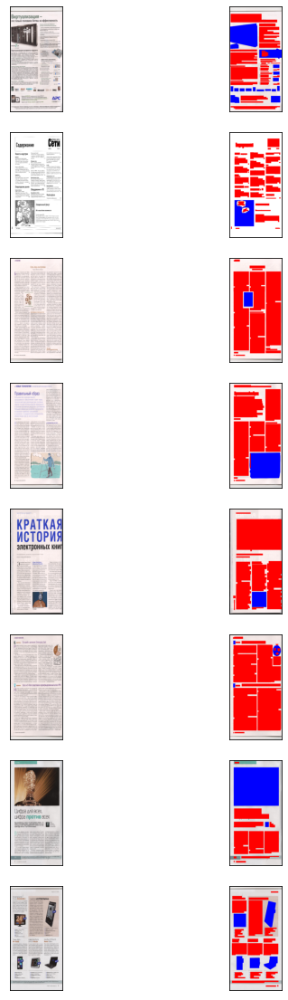

In [ ]:
image_batch, mask_batch = next(my_generator(x_train, y_train, 8))
fix, ax = plt.subplots(8,2, figsize=(8,20))
for i in range(8):
    ax[i,0].set_xticks([])
    ax[i,1].set_xticks([])
    ax[i,0].set_yticks([])
    ax[i,1].set_yticks([])
    ax[i,0].imshow(image_batch[i,:,:,:])
    ax[i,1].imshow(mask_batch[i,:,:,:])
plt.show()

In [ ]:
model.compile(optimizer='adam', loss='binary_crossentropy',  metrics=['accuracy'])

In [ ]:
weight_saver = ModelCheckpoint('News.h5', monitor='val_accuracy', save_best_only=True)
#early = EarlyStopping(monitor='accuracy', patience=3, verbose=1, mode='min')

In [ ]:
hist = model.fit_generator(my_generator(x_train, y_train, 8),
                           steps_per_epoch = 100,
                           validation_data = (x_test, y_test),
                           epochs=20, verbose=1,
                           callbacks = [weight_saver])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/20
100/100 [==============================] - 132s 979ms/step - loss: 0.5897 - accuracy: 0.6490 - val_loss: 0.3916 - val_accuracy: 0.6396
Epoch 2/20
100/100 [==============================] - 89s 893ms/step - loss: 0.3821 - accuracy: 0.6966 - val_loss: 0.3052 - val_accuracy: 0.8512
Epoch 3/20
100/100 [==============================] - 89s 893ms/step - loss: 0.2986 - accuracy: 0.7897 - val_loss: 0.3086 - val_accuracy: 0.7667
Epoch 4/20
100/100 [==============================] - 90s 896ms/step - loss: 0.2798 - accuracy: 0.8153 - val_loss: 0.2998 - val_accuracy: 0.8604
Epoch 5/20
100/100 [==============================] - 90s 897ms/step - loss: 0.2683 - accuracy: 0.8219 - val_loss: 0.2848 - val_accuracy: 0.8614
Epoch 6/20
100/100 [==============================] - 89s 894ms/step - loss: 0.2626 - accuracy: 0.8123 - val_loss: 0.2975 - val_accuracy: 0.8609
Epoch 7/20
100/100 [==============================] - 90s 896ms/step - loss: 0.2565 - accuracy: 0.8131 - val_loss: 0.2744 - val_a

In [ ]:
trainingscore = model.evaluate(x_train, y_train, batch_size=8, verbose=0)
print(trainingscore[0])
print(trainingscore[1])

testingscore = model.evaluate(x_test, y_test, batch_size=8, verbose=0)
print(testingscore[0])
print(testingscore[1])

0.21796979010105133
0.9059256315231323
0.2741018831729889
0.8601796627044678


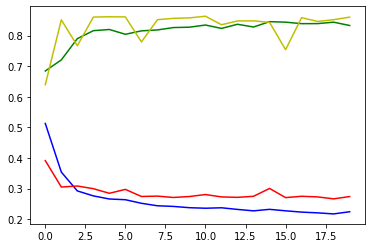

In [ ]:
plt.plot(hist.history['loss'], color='b')
plt.plot(hist.history['val_loss'], color='r')
plt.plot(hist.history['accuracy'], color='g')
plt.plot(hist.history['val_accuracy'], color='y')
plt.show()


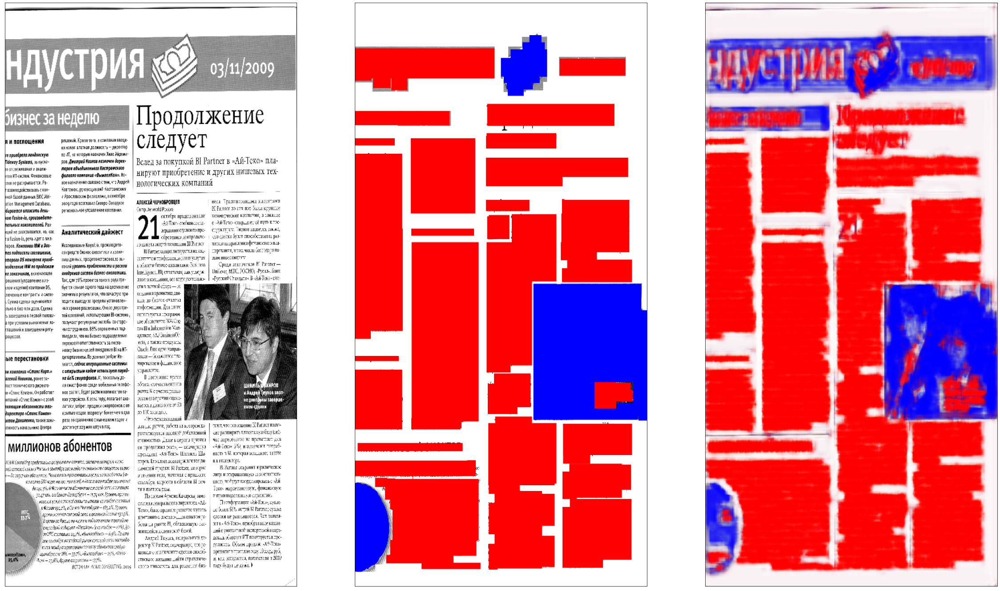

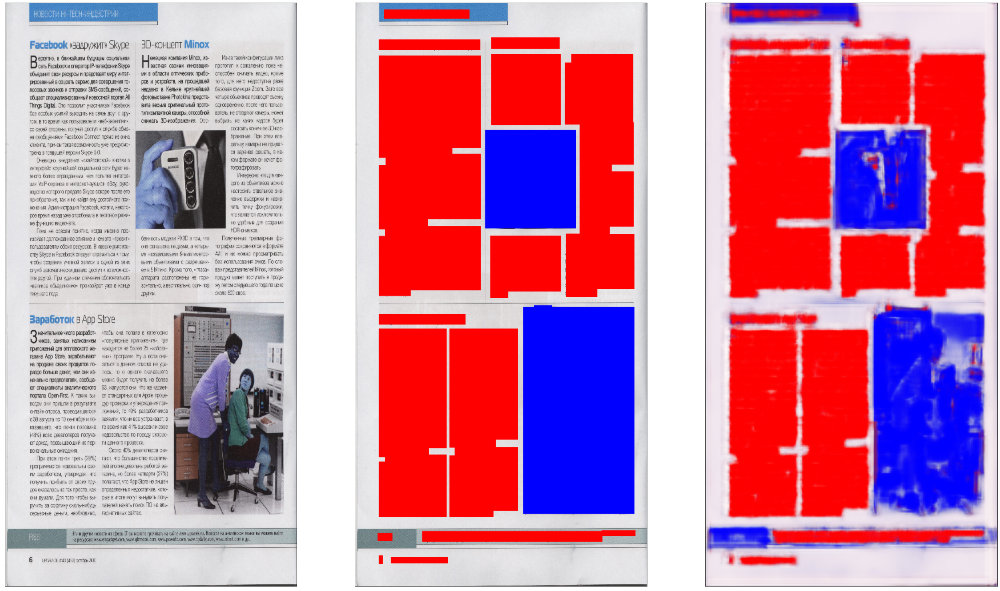

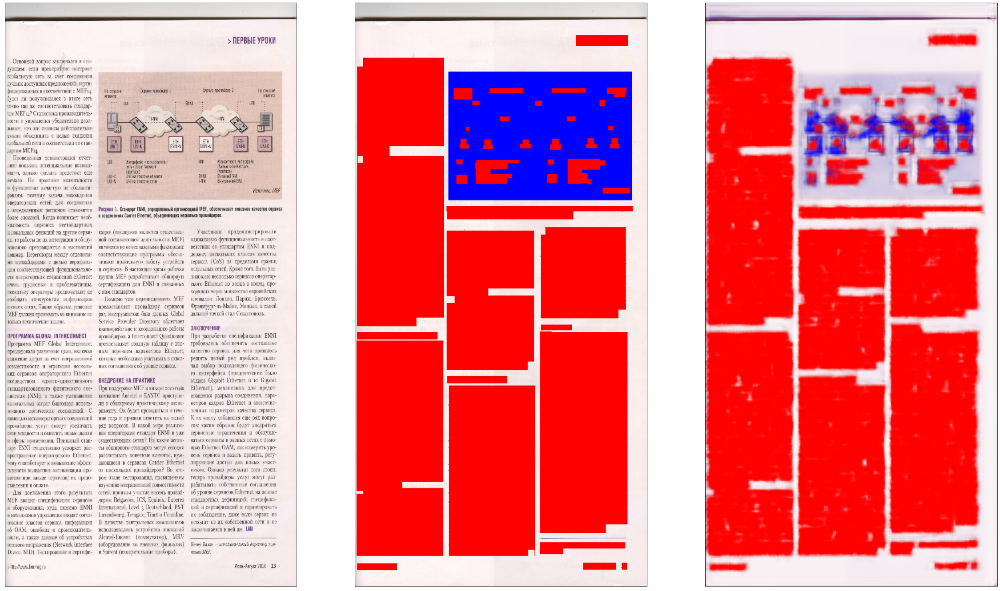

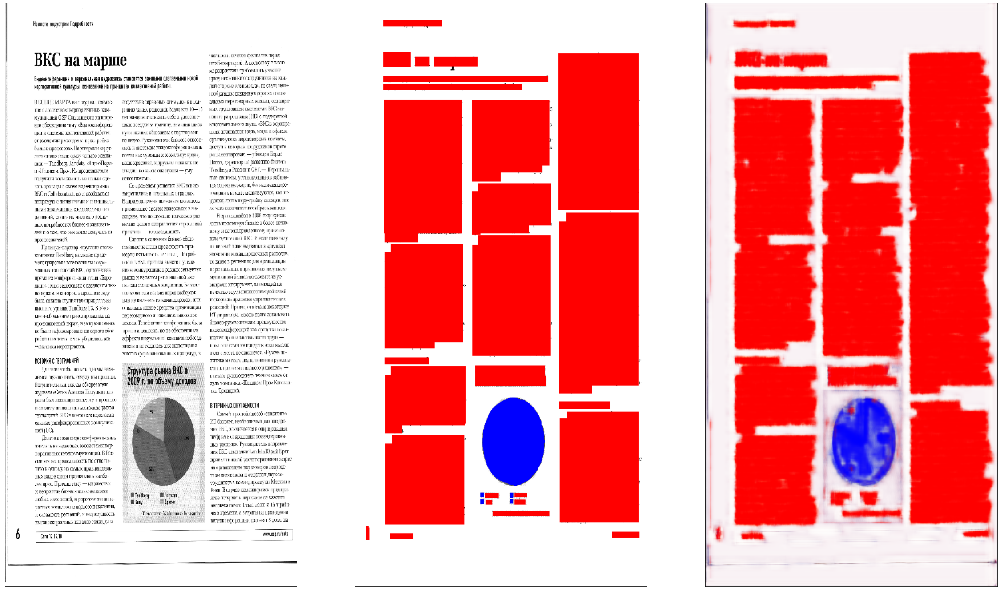

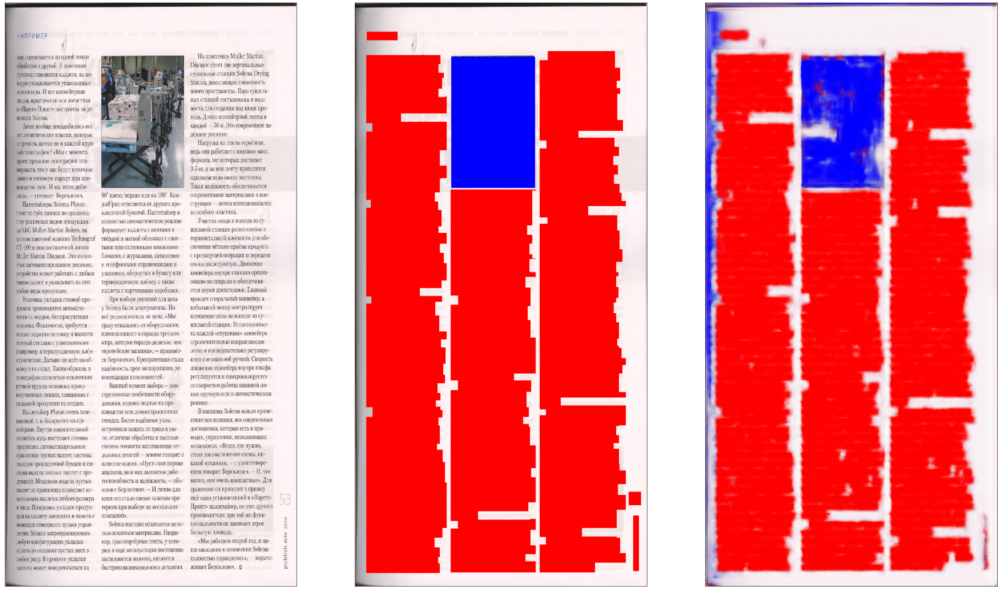

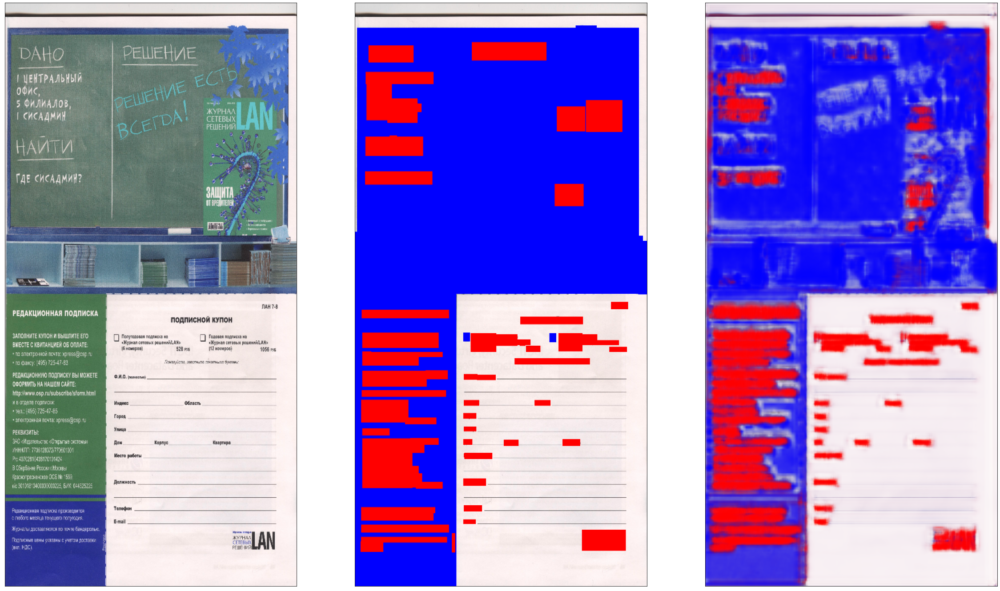

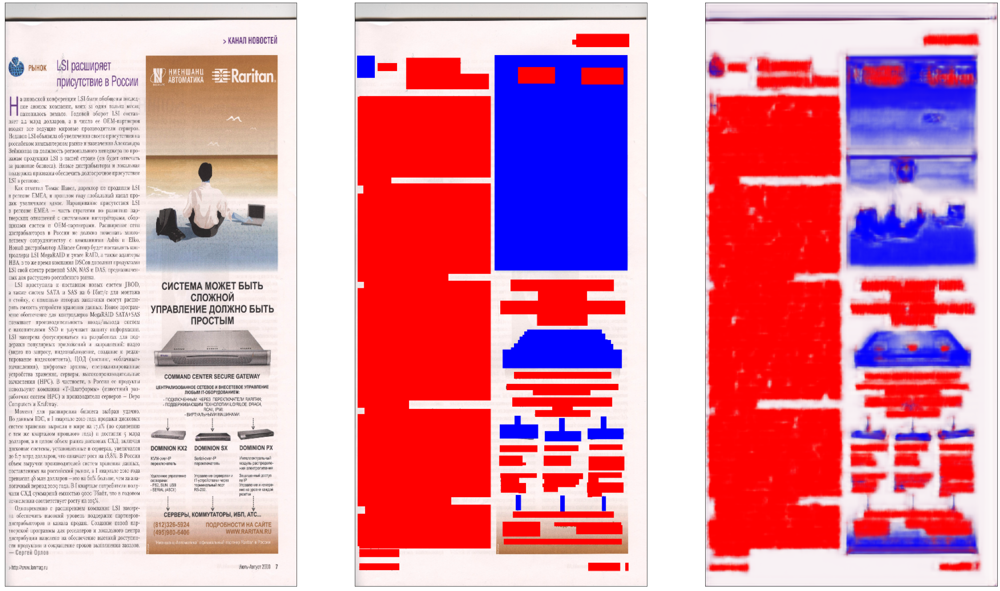

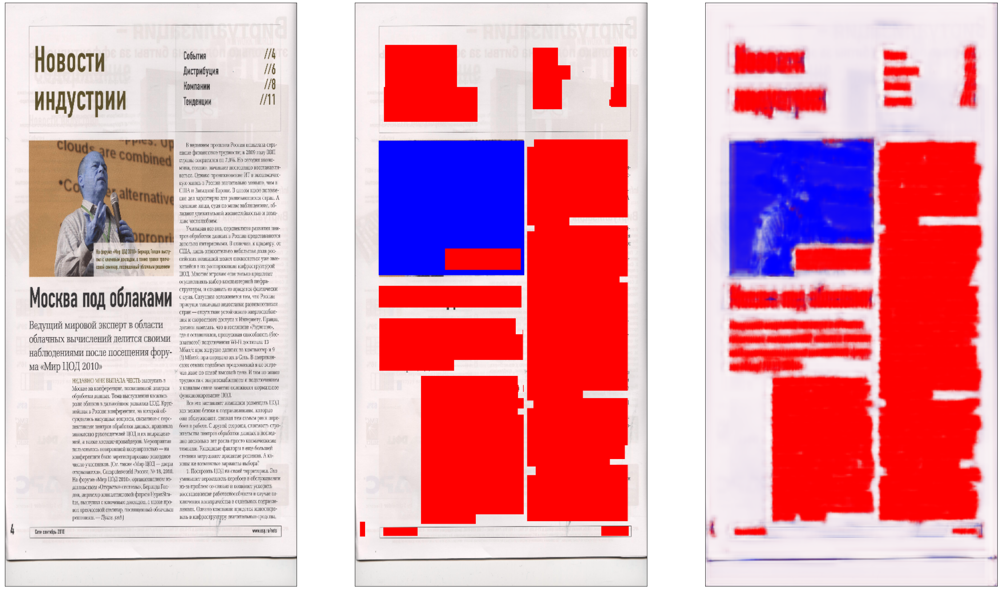

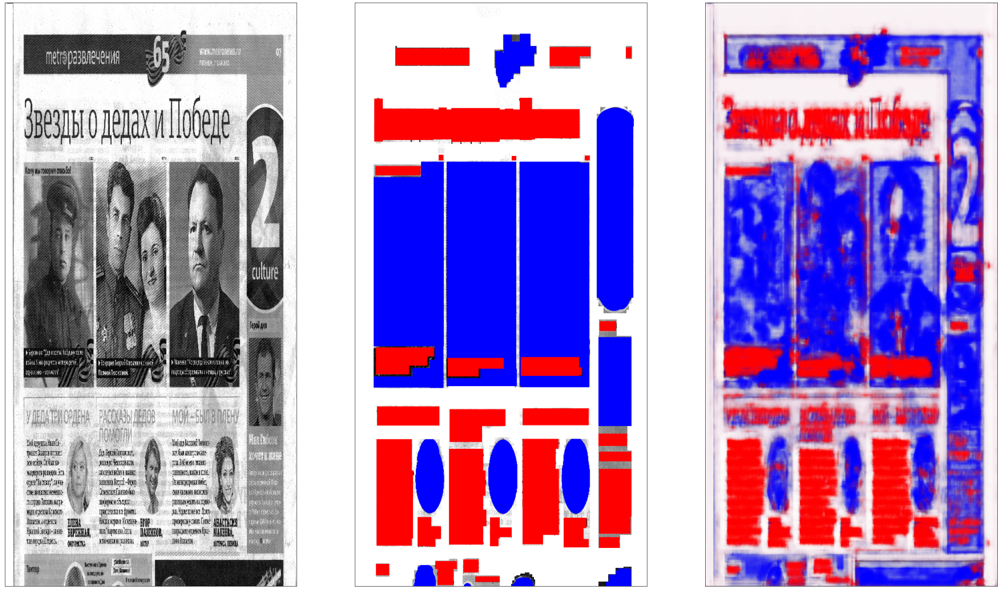

In [ ]:
y_hat = model.predict(x_test)
for i in range(0,9):
  offset = 0
  im_rows = 1
  im_cols = 3
  fig, ax = plt.subplots(offset + im_rows, im_cols, figsize=(40,40))
  ax[0].set_xticks([])
  ax[1].set_xticks([])
  ax[2].set_xticks([])
  ax[0].set_yticks([])
  ax[1].set_yticks([])
  ax[2].set_yticks([])
  ax[0].imshow(x_test[i,:,:,:])
  ax[1].imshow(y_test[i,:,:,:])
  ax[2].imshow(y_hat[i,:,:,:])

***# ------------------------------------------------------------- For Testing Purpose Only ----------------------------------------------------------------------#*** 

1. ***Save Model architecture into json file***
2. ***Save Model HDF5 weight***

In [ ]:
# serialize model to JSON
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)

# serialize weights to HDF5
model.save_weights("model.h5")
print("Saved model to disk")

# save to google drive
!cp model.json "/content/drive/MyDrive/MiniProject/SavedModel/RussianDataset/"
!cp model.h5 "/content/drive/MyDrive/MiniProject/SavedModel/RussianDataset/"

Saved model to disk


1. ***Load saved Model*** 
2. ***Load saved Weight*** 

In [ ]:
model_path ='/content/drive/MyDrive/MiniProject/SavedModel/RussianDataset/model.json'
weight_path = '/content/drive/MyDrive/MiniProject/SavedModel/RussianDataset/model.h5'

# load json and create model
#json_file = open('model.json', 'r')
json_file = open(model_path, 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

# load weights into new model
#loaded_model.load_weights("model.h5")
loaded_model.load_weights(weight_path)
print("Loaded model from disk")


Loaded model from disk


***Evaluate the loaded model***

In [ ]:
# evaluate loaded model on test data
loaded_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
Trainscore = loaded_model.evaluate(x_train, y_train, batch_size = 8, verbose=0)
Testscore = loaded_model.evaluate(x_test, y_test, batch_size = 8, verbose=0)
print("Train loss  : " + str(Trainscore[0]*100))
print("Train Accuracy  : " + str(Trainscore[1]*100))
print("Test Loss  : " + str(Testscore[0]*100))
print("Test Accuracy  : " + str(Testscore[1]*100))

Train loss  : 21.1911603808403
Train Accuracy  : 84.93931293487549
Test Loss  : 26.46659016609192
Test Accuracy  : 84.14719104766846


***For Testing on a Given input image***
  

In [ ]:
IMAGE_LIB = '/content/drive/MyDrive/MiniProject/TestingImage/'
extra = [x for x in sorted(os.listdir(IMAGE_LIB))]
test = np.empty((len(extra), IMG_HEIGHT, IMG_WIDTH, 3), dtype='float32')
for i, name in enumerate(extra):
    im = cv2.imread(IMAGE_LIB+name, cv2.IMREAD_COLOR).astype('float32')/255
    im = cv2.resize(im, (IMG_WIDTH, IMG_HEIGHT))
    test[i] = im


In [ ]:
y_hat = loaded_model.predict(test)
for i in range(0,20,2):
  offset = 0
  im_rows = 1
  im_cols = 2
  fig, ax = plt.subplots(offset + im_rows, im_cols, figsize=(40,40))
  ax[0].set_xticks([])
  ax[1].set_xticks([])
  ax[0].set_yticks([])
  ax[1].set_yticks([])
  ax[0].imshow(test[i,:,:,:])
  ax[1].imshow(y_hat[i,:,:,:])